In [2]:
import sys
import os
import geopandas as gpd
import pandas as pd
import numpy as np

sys.path.append(os.path.abspath(os.path.join(os.pardir)))

from VASA import VASA
from VASA.vasa import filter_data, filter_map

In [2]:
all_counties = gpd.read_file("../data/ca_cbg")

counties_map = gpd.GeoDataFrame \
    .from_features(all_counties) \
    .set_crs(epsg=4326) \
    .to_crs("+proj=aea +lat_1=20 +lat_2=60 +lat_0=40 +lon_0=-96 +x_0=0 +y_0=0 +datum=NAD83 +units=m +no_defs")

In [3]:
help(VASA)

Help on class VASA in module VASA.vasa:

class VASA(builtins.object)
 |  VASA(df: 'str or pd.DataFrame', gdf: 'gpd.GeoDataFrame', df_group_col: 'str' = 'fips', gdf_group_col: 'str' = 'fips', date_col: 'str' = 'date', date_format: 'str' = '%Y-%m-%d', temp_res: "Literal[('day', 'week', 'month', 'year')]" = 'week') -> 'None'
 |  
 |  A standard data object for VASA plots
 |  
 |  
 |  Parameters
 |  ----------
 |  
 |  
 |  Attributes
 |  ----------
 |  
 |  
 |  Examples
 |  --------
 |  >>> import libpysal
 |  
 |  Methods defined here:
 |  
 |  __init__(self, df: 'str or pd.DataFrame', gdf: 'gpd.GeoDataFrame', df_group_col: 'str' = 'fips', gdf_group_col: 'str' = 'fips', date_col: 'str' = 'date', date_format: 'str' = '%Y-%m-%d', temp_res: "Literal[('day', 'week', 'month', 'year')]" = 'week') -> 'None'
 |      DOCSTRING
 |  
 |  agg(self, ag)
 |      # I want to change the name of this
 |  
 |  drop_missing(self, thresh: 'int' = 0.2)
 |  
 |  get_county(self, fips: 'int', date='all') -> 

In [3]:
counties_map.columns

Index(['geometry', 'ALAND', 'AWATER', 'BLKGRPCE', 'COUNTYFP', 'FUNCSTAT',
       'GEOID', 'INTPTLAT', 'INTPTLON', 'MTFCC', 'NAMELSAD', 'STATEFP',
       'TRACTCE'],
      dtype='object')

In [4]:
counties_map.head()

,geometry,ALAND,AWATER,BLKGRPCE,COUNTYFP,FUNCSTAT,GEOID,INTPTLAT,INTPTLON,MTFCC,NAMELSAD,STATEFP,TRACTCE
0,"POLYGON ((-2145182.747 -100760.342, -2144383.6...",3348560,0,1,053,S,060530015001,+36.6564570,-121.6749086,G5030,Block Group 1,06,001500
1,"POLYGON ((-1868837.200 -644245.639, -1868807.0...",337744,0,2,073,S,060730027122,+32.7303521,-117.0787620,G5030,Block Group 2,06,002712
2,"POLYGON ((-1879386.243 -582276.995, -1879380.8...",886725,0,2,073,S,060730186012,+33.2295683,-117.3482855,G5030,Block Group 2,06,018601
3,"POLYGON ((-1875703.108 -580018.426, -1875702.1...",379311,0,3,073,S,060730186093,+33.2495250,-117.3148675,G5030,Block Group 3,06,018609
4,"POLYGON ((-1873233.804 -586940.975, -1873228.3...",649440,0,3,073,S,060730194063,+33.2018708,-117.2686502,G5030,Block Group 3,06,019406


<AxesSubplot:>

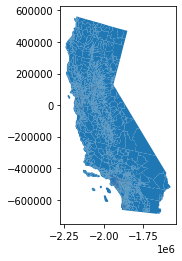

In [5]:
counties_map.plot()

In [3]:
#fire = pd.read_csv("../data/jvn_collect.csv")
#fire.origin_census_block_group = "0" + fire.origin_census_block_group.astype(str)

In [6]:
fire2020 = pd.read_csv("../data/lakefire2020_data.csv")
fire2020.origin_census_block_group = "0" + fire2020.origin_census_block_group.astype(str)

In [7]:
fire2020.head()

,Unnamed: 0,origin_census_block_group,date_range_start,date_range_end,device_count,distance_traveled_from_home,bucketed_distance_traveled,median_dwell_at_bucketed_distance_traveled,completely_home_device_count,median_home_dwell_time,...,destination_cbgs,delivery_behavior_devices,median_non_home_dwell_time,candidate_device_count,bucketed_away_from_home_time,median_percentage_time_home,bucketed_percentage_time_home,mean_home_dwell_time,mean_non_home_dwell_time,mean_distance_traveled_from_home
0,1,060371012201,2019-06-12 07:00:00,2019-06-13 07:00:00,111,3004,"{""16001-50000"":19,""0"":38,"">50000"":6,""2001-8000...","{""16001-50000"":33,"">50000"":95,""<1000"":81,""2001...",37,312,...,"{""060371046201"":1,""060371012202"":3,""0603710130...",5,71,396,"{""21-45"":5,""481-540"":2,""541-600"":1,""46-60"":2,""...",84,"{""0-25"":28,""76-100"":58,""51-75"":12,""26-50"":4}",503,187,30432
1,2,060371066452,2019-06-12 07:00:00,2019-06-13 07:00:00,115,3164,"{""16001-50000"":30,""0"":31,"">50000"":7,""2001-8000...","{""16001-50000"":44,"">50000"":111,""<1000"":325,""20...",26,775,...,"{""060372151011"":1,""060379203364"":2,""0603714390...",1,149,225,"{""21-45"":4,""481-540"":3,""541-600"":7,""46-60"":4,""...",85,"{""0-25"":13,""76-100"":67,""51-75"":29,""26-50"":6}",746,284,6983
2,3,060371210102,2019-06-12 07:00:00,2019-06-13 07:00:00,58,4271,"{""16001-50000"":7,""0"":18,"">50000"":4,""2001-8000""...","{""16001-50000"":57,"">50000"":26,""<1000"":50,""2001...",19,597,...,"{""060373106012"":1,""060371048102"":1,""0603710130...",4,94,174,"{""21-45"":1,""481-540"":1,""541-600"":2,""721-840"":1...",85,"{""0-25"":10,""76-100"":29,""51-75"":9,""26-50"":4}",588,213,23954
3,4,060371342012,2019-06-12 07:00:00,2019-06-13 07:00:00,79,1417,"{""16001-50000"":15,""0"":18,"">50000"":1,""2001-8000...","{""16001-50000"":63,"">50000"":60,""<1000"":28,""2001...",24,798,...,"{""060371349051"":3,""060371048102"":1,""0603713520...",6,109,176,"{""21-45"":6,""481-540"":5,""46-60"":1,""721-840"":1,""...",83,"{""0-25"":7,""76-100"":44,""51-75"":18,""26-50"":4}",774,223,3215
4,5,060371959011,2019-06-12 07:00:00,2019-06-13 07:00:00,77,1681,"{""16001-50000"":5,""0"":28,"">50000"":3,""2001-8000""...","{""16001-50000"":87,"">50000"":21,""<1000"":87,""2001...",29,364,...,"{""060371952011"":2,""060372145012"":1,""0603731100...",1,32,185,"{""21-45"":7,""481-540"":5,""541-600"":2,""46-60"":1,""...",81,"{""0-25"":22,""76-100"":41,""51-75"":8,""26-50"":2}",512,167,2749


In [9]:
v = VASA(
    df=fire2020[["origin_census_block_group", "date_range_start", "distance_traveled_from_home"]],
    gdf=counties_map,
    df_group_col="origin_census_block_group",
    gdf_group_col="GEOID",
    date_col="date_range_start",
    temp_res="week",
    date_format="%Y-%m-%d %H:%M:%S" # %z
)

In [10]:
v.group()

In [11]:
v.pct_full_missing()

array([77.04533917])

In [12]:
v.drop_missing(thresh=0.2)

In [13]:
v.pct_full_missing()

array([0.])

In [14]:
v.pct_partial_missing()

array([0.31067251])

In [15]:
v.impute()

In [16]:
v.pct_partial_missing()

array([0.])

/home/alex/Desktop/github/VASA/myenv/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 4 disconnected components.
  warnings.warn(message)


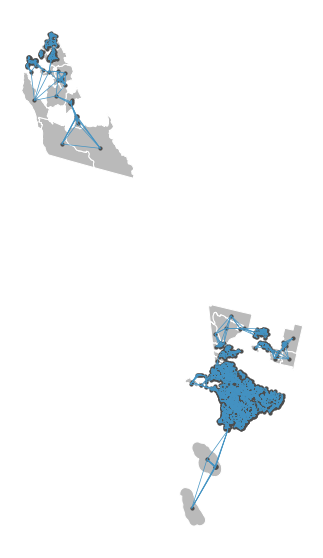

In [17]:
v.show_weights_connection(k=5)

In [18]:
alameda2020 = pd.read_csv("../data/jvn_collect_alameda2020.csv")
alameda2020.origin_census_block_group = "0" + alameda2020.origin_census_block_group.astype(str)

v_alameda2020 = VASA(
    df=alameda2020[["origin_census_block_group", "date_range_start", "distance_traveled_from_home"]],
    gdf=counties_map,
    df_group_col="origin_census_block_group",
    gdf_group_col="GEOID",
    date_col="date_range_start",
    temp_res="week",
    date_format="%Y-%m-%d %H:%M:%S%z"
)
v_alameda2020.group()

<AxesSubplot:>

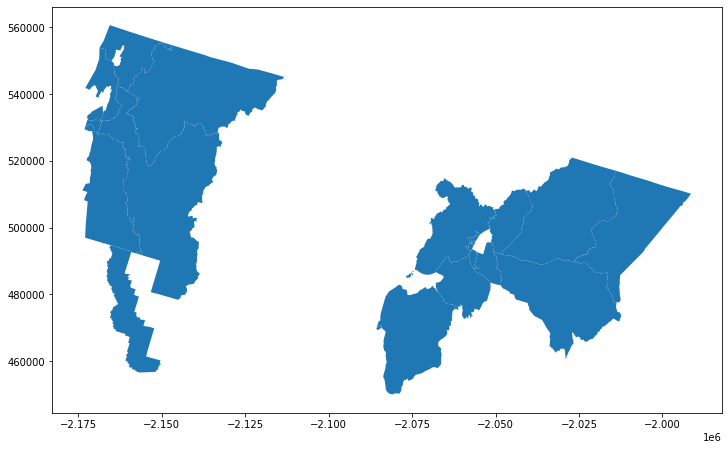

In [22]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 1, figsize=(12, 12))

counties_map.merge(
    pd.DataFrame({"fips": alameda2020.origin_census_block_group.unique()}),
    left_on="GEOID",
    right_on="fips",
    how="right"
).reset_index(drop=True).plot(ax=ax)


[99.91018081]
[0.]
[0.]
[0.]


/home/alex/Desktop/github/VASA/myenv/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


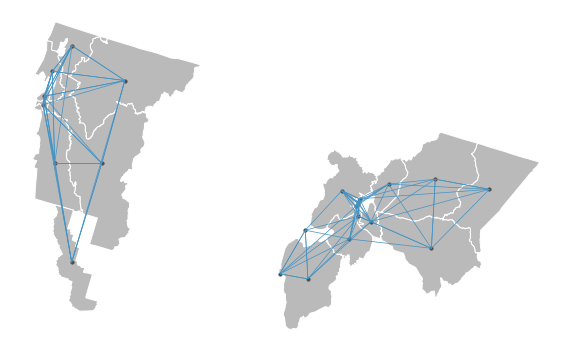

In [23]:
print(v_alameda2020.pct_full_missing())
v_alameda2020.drop_missing()
print(v_alameda2020.pct_full_missing())
print(v_alameda2020.pct_partial_missing())
v_alameda2020.impute()
print(v_alameda2020.pct_partial_missing())
v_alameda2020.show_weights_connection(k=5)


In [24]:
alameda2019 = pd.read_csv("../data/jvn_collect_alameda_2019.csv")
alameda2019.origin_census_block_group = "0" + alameda2019.origin_census_block_group.astype(str)

v_alameda2019 = VASA(
    df=alameda2019[["origin_census_block_group", "date_range_start", "distance_traveled_from_home"]],
    gdf=counties_map,
    df_group_col="origin_census_block_group",
    gdf_group_col="GEOID",
    date_col="date_range_start",
    temp_res="week",
    date_format="%Y-%m-%d %H:%M:%S%z"
)
v_alameda2019.group()

[99.91018081]
[0.]
[0.]
[0.]


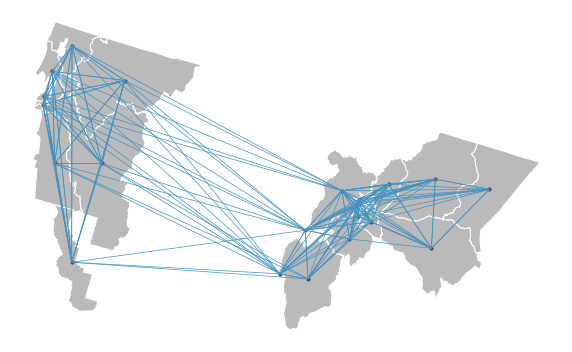

In [25]:
print(v_alameda2019.pct_full_missing())
v_alameda2019.drop_missing()
print(v_alameda2019.pct_full_missing())
print(v_alameda2019.pct_partial_missing())
v_alameda2019.impute()
print(v_alameda2019.pct_partial_missing())
v_alameda2019.show_weights_connection(k=10)

In [3]:
lakefire2019 = pd.read_csv("../data/lakefire2019_data.csv")
lakefire2019.origin_census_block_group = "0" + lakefire2019.origin_census_block_group.astype(str)

v_lf19 = VASA(
    df=lakefire2019[["origin_census_block_group", "date_range_start", "distance_traveled_from_home"]],
    gdf=counties_map,
    df_group_col="origin_census_block_group",
    gdf_group_col="GEOID",
    date_col="date_range_start",
    temp_res="week",
    date_format="%Y-%m-%d %H:%M:%S"
)
v_lf19.group()

<AxesSubplot:>

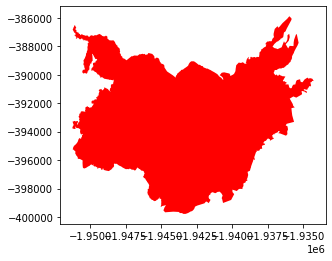

In [4]:
lake_fire = gpd.read_file("../data/lake_fire") \
    .set_crs(epsg=4326) \
    .to_crs("+proj=aea +lat_1=20 +lat_2=60 +lat_0=40 +lon_0=-96 +x_0=0 +y_0=0 +datum=NAD83 +units=m +no_defs")

lake_fire.plot(color="red")

[77.06486508]
[0.]
[0.06821282]
[0.]


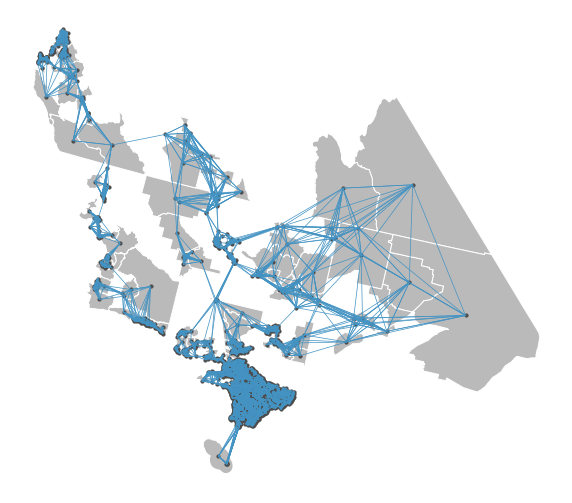

In [5]:
print(v_lf19.pct_full_missing())
v_lf19.drop_missing()
print(v_lf19.pct_full_missing())
print(v_lf19.pct_partial_missing())
v_lf19.impute()
print(v_lf19.pct_partial_missing())
v_lf19.show_weights_connection(k=10)

<AxesSubplot:>

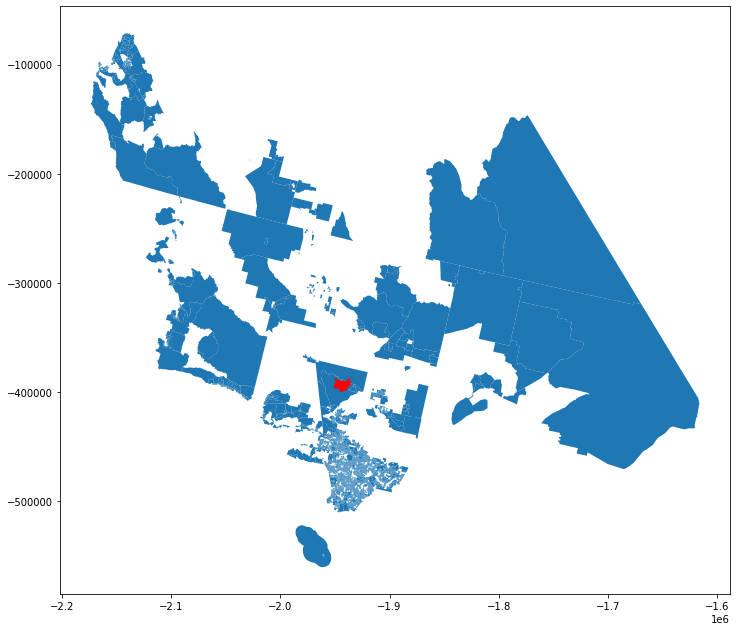

In [6]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 1, figsize=(12, 12))


v_lf19.gdf.plot(ax=ax)
lake_fire.plot(ax=ax, color="red")

In [16]:
%pip install pygeos

     |████████████████████████████████| 2.0 MB 997 kB/s 
Note: you may need to restart the kernel to use updated packages.


In [18]:
surrounding_cbgs = gpd.overlay(lake_fire, v_lf19.gdf, how='intersection')

<AxesSubplot:>

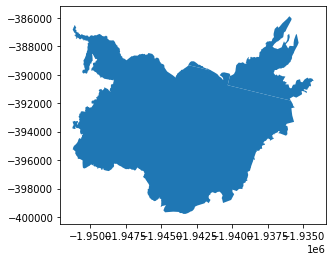

In [19]:
surrounding_cbgs.plot()

In [8]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 1, figsize=(12, 12))

counties_map.plot(ax=ax, color="gray")
v_lf19.gdf.plot(ax=ax)
lake_fire.plot(ax=ax, color="red")

<AxesSubplot:>